## Notebook containing code used for manuscript supplementary figure 6

### Change each file path to the relevant local folder after downloading the data
### Figure 6a/b plots require PyVista and cannot easily run natively on Windows

In [ ]:
# Install Xvfb to render PyVista plots in notebook on Linux, if necessary- this can be done with:
# sudo apt install libgl1-mesa-glx xvfb

In [ ]:
# And imgkit to display HTML files inline
# First install on Linux:
# sudo apt-get install wkhtmltopdf
# !pip install imgkit

In [1]:
import anndata
import imgkit
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
import seaborn as sns
import sys

import plotly.graph_objects as go
import scipy
from IPython.display import display, HTML
from PIL import Image

import scanpy as sc
import spateo as st

import pyvista as pv
pv.global_theme.transparent_background = False
# For Pyvista plotting in headless environment (Mac, Windows or Linux)
pv.start_xvfb()

2024-08-17 16:52:04.950614: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-08-17 16:52:04.987249: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-08-17 16:52:05.594101: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [2]:
np.random.seed(888)

In [3]:
%config InlineBackend.print_figure_kwargs={'dpi': 300.0}

In [4]:
# For all PyVista plots here:
from typing import Optional, Tuple, Union

import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
from pyvista import PolyData, UnstructuredGrid

try:
    from typing import Literal
except ImportError:
    from typing_extensions import Literal


def add_model_labels(
        model: Union[PolyData, UnstructuredGrid],
        labels: np.ndarray,
        key_added: str = "groups",
        where: Literal["point_data", "cell_data"] = "cell_data",
        colormap: Union[str, list, dict, np.ndarray] = "rainbow",
        alphamap: Union[float, list, dict, np.ndarray] = 1.0,
        mask_color: Optional[str] = "gainsboro",
        mask_alpha: Optional[float] = 0.0,
        inplace: bool = False,
) -> Tuple[Optional[PolyData or UnstructuredGrid], Optional[Union[str]]]:
    model = model.copy() if not inplace else model
    labels = np.asarray(labels).flatten()

    cu_arr = np.sort(np.unique(labels), axis=0).astype(object)
    raw_labels_hex = labels.copy().astype(object)
    raw_labels_alpha = labels.copy().astype(object)
    raw_labels_hex[raw_labels_hex == "mask"] = mpl.colors.to_hex(mask_color)
    raw_labels_alpha[raw_labels_alpha == "mask"] = mask_alpha

    # Set raw hex.
    if isinstance(colormap, str):
        if colormap in list(mpl.colormaps()):
            lscmap = mpl.cm.get_cmap(colormap)
            raw_hex_list = [mpl.colors.to_hex(lscmap(i)) for i in np.linspace(0, 1, len(cu_arr))]
            for label, color in zip(cu_arr, raw_hex_list):
                raw_labels_hex[raw_labels_hex == label] = color
        else:
            raw_labels_hex[raw_labels_hex != "mask"] = mpl.colors.to_hex(colormap)
    elif isinstance(colormap, dict):
        for label, color in colormap.items():
            raw_labels_hex[raw_labels_hex == label] = mpl.colors.to_hex(color)
    elif isinstance(colormap, list) or isinstance(colormap, np.ndarray):
        raw_hex_list = np.array([mpl.colors.to_hex(color) for color in colormap]).astype(object)
        for label, color in zip(cu_arr, raw_hex_list):
            raw_labels_hex[raw_labels_hex == label] = color
    else:
        raise ValueError("`colormap` value is wrong." "\nAvailable `colormap` types are: `str`, `list` and `dict`.")

    # Set raw alpha.
    if isinstance(alphamap, float) or isinstance(alphamap, int):
        raw_labels_alpha[raw_labels_alpha != "mask"] = alphamap
    elif isinstance(alphamap, dict):
        for label, alpha in alphamap.items():
            raw_labels_alpha[raw_labels_alpha == label] = alpha
    elif isinstance(alphamap, list) or isinstance(alphamap, np.ndarray):
        raw_labels_alpha = np.asarray(alphamap).astype(object)
    else:
        raise ValueError(
            "`alphamap` value is wrong." "\nAvailable `alphamap` types are: `float`, `list` and `dict`."
        )

    # Set rgba.
    labels_rgba = [mpl.colors.to_rgba(c, alpha=a) for c, a in zip(raw_labels_hex, raw_labels_alpha)]
    labels_rgba = np.array(labels_rgba).astype(np.float32)

    # Added rgba of the labels.
    if where == "point_data":
        model.point_data[f"{key_added}_rgba"] = labels_rgba
    else:
        model.cell_data[f"{key_added}_rgba"] = labels_rgba

    plot_cmap = None

    # Added labels.
    if where == "point_data":
        model.point_data[key_added] = labels
    else:
        model.cell_data[key_added] = labels

    return model if not inplace else None, plot_cmap

In [5]:
img_out_dir = "/home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures"

## Resources for both the Midbrain-hindbrain boundary and spinal cord can be found here: https://www.dropbox.com/scl/fo/sxaqo4320hd16n183m6ph/ABzrK0DqPKcATdyPOId19M4?rlkey=v3vl90c8ct53upmfxtiflwnxo&st=q5itka64&dl=0

## Database files used here can be found: https://www.dropbox.com/scl/fo/dcd95so9zhkb8lnjkkxep/ANwmkFeb-sgtS89leHQezlU?rlkey=saiul4j5rr1vt6lwjl4hirmwh&st=brpjqw2c&dl=0

In [6]:
# Set the Spateo database directory here:
database_dir = "/home/danielyumengzhu/spateo-release/spateo/tools/database"

## Load MHB data object

In [7]:
# Replace with wherever this file is stored locally
#path_to_mhb = "/mnt/d/SCData/Spateo_data/Stereo-seq_MHB/E11.5_MHB.h5ad"
path_to_mhb = "/home/danielyumengzhu/Single-cell-data/cellbin_mouse_embryo_aligned_E11.5/E11.5_MHB_final.h5ad"

In [8]:
mhb = anndata.read_h5ad(path_to_mhb)
mhb

AnnData object with n_obs × n_vars = 124307 × 21717
    obs: 'area', 'n_genes_by_counts', 'louvain', 'transf_anno', 'ManualAnnotation', 'slice_id', 'embryo_id', 'mapped_celltype', 'total_counts', 'n_counts', 'rc_coord'
    obsm: 'X_pca', 'bbox', 'spatial', 'z_correction'
    layers: 'count'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [9]:
mhb.uns["__type"] = "UMI"

#### Initialize and run CCI model (can skip if predictions .csv file was created locally or downloaded from the folder)

In [10]:
# Set to the folders that the inputs (ligands list, target genes list) are contained in and that the outputs (model results) will save to:
cci_input_directory = "/home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/MHB_CCI_analysis_inputs"
cci_output_directory = "/home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/key_mhb_genes"
cci_output_id = os.path.join(cci_output_directory, "key_mhb_genes.csv")
cci_ligands_file = os.path.join(cci_input_directory, "mhb_ligands.txt")
cci_targets_file = os.path.join(cci_input_directory, "mhb_targets.txt")

In [11]:
# Upper and lower bounds for the spatially-weighted regression model
lb = 6.42
ub = 15.97

In [ ]:
# This is how the above distance bounds are determined
lb = st.tl.find_neighbors.find_bw_for_n_neighbors(
    mhb,
    coords_key="z_correction",
    n_anchors=2000,
    target_n_neighbors=27,
    initial_bw=20,
    exclude_self=True
)
lb

In [ ]:
ub = st.tl.find_neighbors.find_bw_for_n_neighbors(
    mhb,
    coords_key="z_correction",
    n_anchors=2000,
    target_n_neighbors=270,
    initial_bw=20,
    exclude_self=True
)
ub

In [12]:
adata_path = path_to_mhb
output_path = cci_output_id
ligand_path = cci_ligands_file
target_path = cci_targets_file
cci_dir_path = database_dir
mod_type = "ligand"
distr = "poisson"
species = "mouse"
group_key = "mapped_celltype"
coords_key = "z_correction"
distance_membrane_bound = lb
distance_secreted = ub
# Due to the scale of the dataset, quick fitting is not simple, incorporate spatial subsampling
spatial_subsample = True
total_counts_key = "total_counts"
total_counts_threshold = 2000.0
minbw = lb
maxbw = ub * 1.5

if not os.path.exists(os.path.dirname(output_path)):
    os.makedirs(os.path.dirname(output_path))

In [13]:
parser, args_list = st.tl.define_spateo_argparse(
    adata_path=adata_path,
    custom_lig_path=ligand_path,
    targets_path=target_path,
    cci_dir=cci_dir_path,
    mod_type=mod_type,
    distr=distr,
    species=species,
    group_key=group_key,
    coords_key=coords_key,
    distance_membrane_bound=distance_membrane_bound,
    distance_secreted=distance_secreted,
    spatial_subsample=spatial_subsample,
    total_counts_key=total_counts_key,
    total_counts_threshold=total_counts_threshold,
    minbw=minbw,
    maxbw=maxbw,
    output_path=output_path,
)

In [ ]:
import time

t1 = time.time()

swr_model = st.tl.MuSIC(parser, args_list)
swr_model._set_up_model()
swr_model.fit()
swr_model.predict_and_save(adjust_for_subsampling=True)

t_last = time.time()

print("Total Time Elapsed:", np.round(t_last - t1, 2), "seconds")
print("-" * 60)

In [14]:
# Use the same parser object to set up downstream analysis
downstream_model = st.tl.MuSIC_Interpreter(parser, args_list)

------------------------------------------------------------
|-----> Spatial kernel: Adaptive Bisquare
|-----> Loading AnnData object from: /home/danielyumengzhu/Single-cell-data/cellbin_mouse_embryo_aligned_E11.5/E11.5_MHB_final.h5ad
|-----> Model type: ligand
|-----> Loading cell-cell interaction databases from the following folder:  /home/danielyumengzhu/spateo-release/spateo/tools/database.
|-----> Using list of custom ligands from: /home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/MHB_CCI_analysis_inputs/mhb_ligands.txt.
|-----> Using list of target genes from: /home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/MHB_CCI_analysis_inputs/mhb_targets.txt.
|-----> Saving all outputs to this directory: /home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/key_mhb_genes.
|-----> Running :func `SWR._set_up_model()` to organize predictors and targets for downstream analysis now...
|-----> Found existing independent variable matrix, 

### Figure S6a- spatial enrichment of ligands and target genes

In [15]:
save_path = "/home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/MHB_rc_coord.html"
png_path = save_path.replace("html", "png")

In [16]:
axis = mhb.obs["rc_coord"]

x = mhb.obsm['z_correction'][:, 0]
y = mhb.obsm['z_correction'][:, 1]
z = mhb.obsm['z_correction'][:, 2]

fig = go.Figure(data=[go.Scatter3d(
    x=x,
    y=y,
    z=z,
    mode='markers',
    marker=dict(
        size=4,
        color=axis,  
        colorscale='Inferno',   
        colorbar=dict(title='R-C coordinate'),
    )
)])

title_dict = dict(
    text="Coordinate",
    y=0.9,
    yanchor="top",
    x=0.5,
    xanchor="center",
    font=dict(size=36),
)
fig.update_layout(
    scene=dict(
        aspectmode="data",
        xaxis=dict(
            showgrid=False,
            showline=False,
            linewidth=2,
            linecolor="black",
            backgroundcolor="white",
            title="",
            showticklabels=False,
            ticks="",
        ),
        yaxis=dict(
            showgrid=False,
            showline=False,
            linewidth=2,
            linecolor="black",
            backgroundcolor="white",
            title="",
            showticklabels=False,
            ticks="",
        ),
        zaxis=dict(
            showgrid=False,
            showline=False,
            linewidth=2,
            linecolor="black",
            backgroundcolor="white",
            title="",
            showticklabels=False,
            ticks="",
        ),
    ),
    margin=dict(l=0, r=0, b=0, t=50),  # Adjust margins to minimize spacing
    title=title_dict,
)

fig.write_html(save_path)

Loading page (1/2)
Rendering (2/2)                                                    
Done                                                               


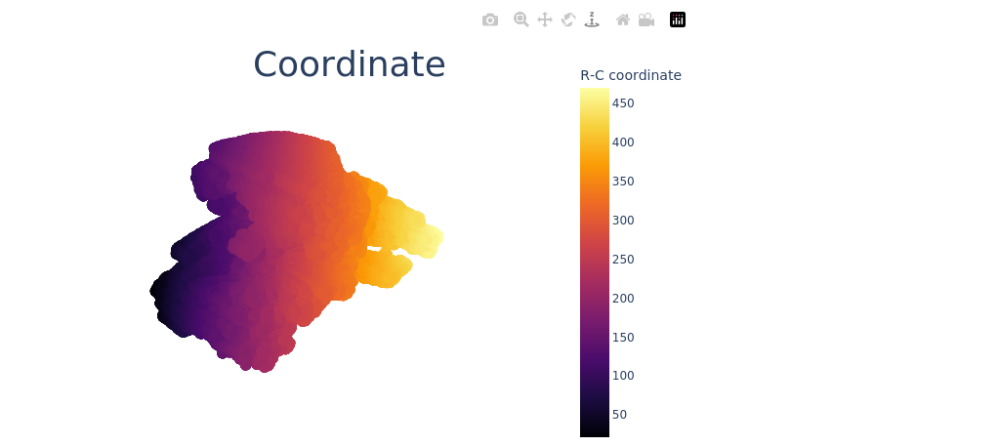

In [17]:
imgkit.from_file(save_path, png_path)
img = Image.open(png_path)
img.save(png_path, dpi=(300, 300))
display(img)

|-----> Sorting by position of enrichment along axis...


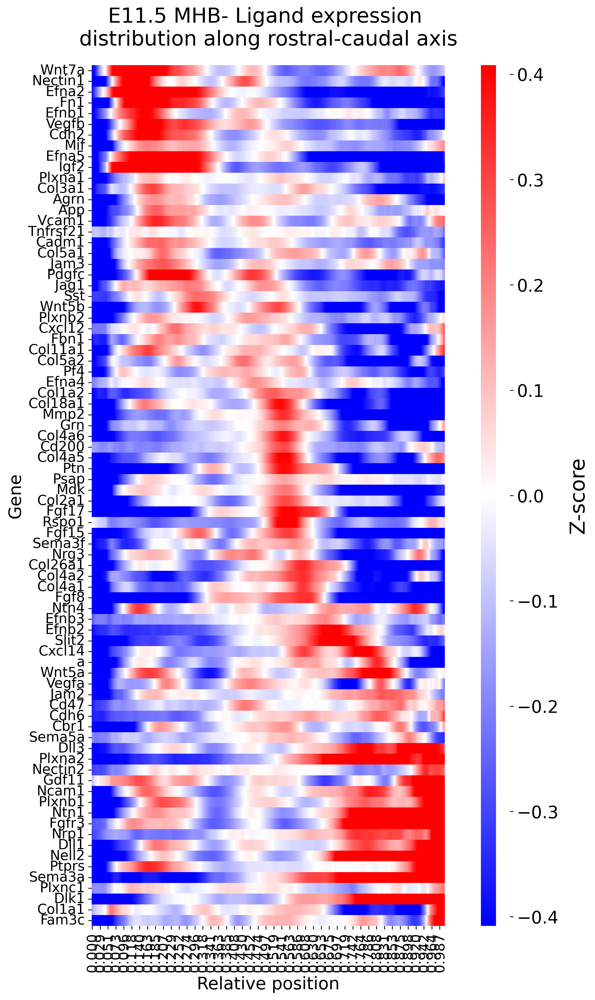

In [18]:
# Visualize the enrichments of ligands and target genes along this axis- patterns coincident with Fgf8 are enriched in the midbrain-hindbrain boundary, to the anterior side there is enrichment in the midbrain,
# and the posterior side enrichment in the hindbrain
downstream_model.gene_expression_heatmap(
    use_ligands=True,
    position_key="rc_coord",
    neatly_arrange_y=True,
    window_size=35,
    cmap="bwr",
    title="E11.5 MHB- Ligand expression \ndistribution along rostral-caudal axis",
    fontsize=14,
)

|-----> Sorting by position of enrichment along axis...


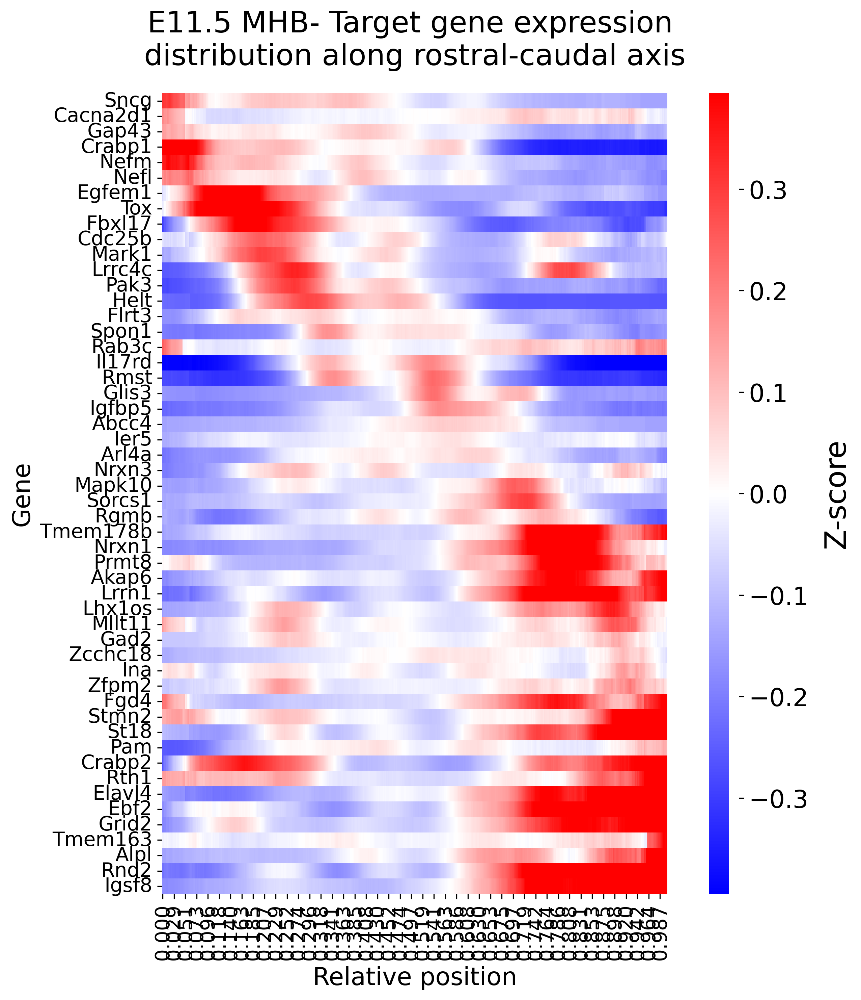

In [19]:
downstream_model.gene_expression_heatmap(
    use_target_genes=True,
    position_key="rc_coord",
    neatly_arrange_y=True,
    window_size=35,
    cmap="bwr",
    title="E11.5 MHB- Target gene expression \ndistribution along rostral-caudal axis",
    fontsize=14,
)

### Figure S6b- MHB inferred signaling effect heatmap (can skip this section if for_E11.5_MHB_heatmap file was downloaded)

In [ ]:
mhb = anndata.read_h5ad(path_to_mhb)
mhb.uns["__type"] = "UMI"

In [ ]:
def analyze_CCI_outputs(adata, gene_files_folder):
    results_dict = {}
    # Load the list of genes from the provided CSV files
    gene_files = os.listdir(gene_files_folder)
    
    for gene_file in tqdm(gene_files, desc="Processing all target genes..."):
        # Check and load only CSV files
        if not gene_file.endswith(".csv") or "predictions" in gene_file:
            continue
        
        # Extract the gene name from the file name
        gene_name = gene_file.split('_')[-1].split(".")[0]
        
        # Get the CCI results corresponding to this gene
        df = pd.read_csv(f"{gene_files_folder}/{gene_file}", index_col=0)

        for cell_type in ["Midbrain neuroectoderm", "Hindbrain neuroectoderm", "Midbrain-hindbrain boundary"]:
            type_cells = adata[adata.obs["mapped_celltype"] == cell_type].copy()
            # Get indices of cells of the current cell type
            indices = type_cells.obs.index
            
            # For each column in the DataFrame, calculate the proportion of non-zero entries for the current cell type
            proportions = (df.loc[indices] > 0).mean()
        
            # Store the proportions in the result dictionary
            for col in df.columns:
                results_key = f"{cell_type}-{col}"
                if results_key not in results_dict:
                    results_dict[results_key] = {}
                results_dict[results_key][gene_name] = proportions[col]
                
            # Clear intermediate large variables and suggest the GC to reclaim memory
            del type_cells, indices, proportions
            gc.collect()

        # Optionally clear the DataFrame read from file after processing
        del df
        gc.collect()
    
    # Convert results dictionary to DataFrame
    results_df = pd.DataFrame(results_dict)
    return results_df

In [ ]:
results = analyze_CCI_outputs(mhb, cci_output_directory)
results

In [ ]:
save_dir = "/home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/MHB_CCI_analysis_inputs"
results.to_csv(os.path.join(save_dir, "for_E11.5_MHB_heatmap.csv"))

In [ ]:
results = pd.read_csv(os.path.join(save_dir, "for_E11.5_MHB_heatmap.csv"), index_col=0)

In [ ]:
# Remove sets of columns if the ligand does not really have a large effect on any gene:
targets = set(col.split('-')[1] for col in results.columns)

# Iterate through each suffix
for target in targets:
    # Collect columns for the current suffix
    cols = [col for col in results.columns if col.endswith(target)]
    
    # Check if all values in these columns are < 0.1
    if results[cols].apply(lambda x: (x < 0.1).all()).all():
        # Remove these columns if the condition is met
        results.drop(columns=cols, inplace=True)
        
# Similarly, remove rows if no large effects are present:
results = results[(results.index == "Abcc4") | ~results.apply(lambda x: (x < 0.1).all(), axis=1)]
        
results = results[[c for c in results.columns if "se_" not in c]]
results

In [ ]:
# Normalize each row, scale for visuals
results = results.apply(lambda x: (x - x.min()) / (x.max() - x.min()), axis=1) ** 2
results

In [ ]:
results.to_csv(os.path.join(save_dir, "for_E11.5_MHB_heatmap.csv"))

#### Load heatmap file

In [20]:
save_dir = "/home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/MHB_CCI_analysis"

In [21]:
results = pd.read_csv(os.path.join(save_dir, "for_E11.5_MHB_heatmap.csv"), index_col=0)
# Mllt11 has many NaNs, do not include it:
results = results.loc[[i for i in results.index if i != "Mllt11"]]
results.columns = [c.replace("Midbrain-hindbrain boundary", "MHB NE") for c in results.columns]
results.columns = [c.replace("Midbrain neuroectoderm", "Midbrain NE") for c in results.columns]
results.columns = [c.replace("Hindbrain neuroectoderm", "Hindbrain NE") for c in results.columns]

In [22]:
# Custom order for target genes:
targets = ["Cdc25b", "Fbxl17", "Helt", "Lrrc4c", "Pak3", "Tox", "Rgmb", "Il17rd", "Pam", "Akap6", "Ebf2", "Elavl4", "Fgd4", "Grid2", "Igsf8", "Nrxn1", "Rnd2", "Lrrn1", "Abcc4", "Igfbp5", "Rmst"]

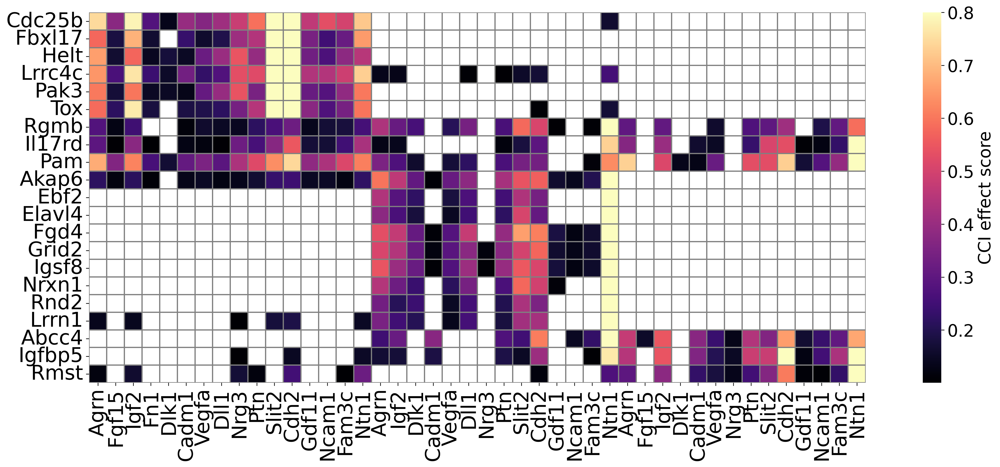

In [23]:
column_labels = results.columns.str.split('-', expand=True)
column_labels.columns = ['Group', 'Detail']
column_labels = column_labels.tolist()
# Reorder DataFrame columns with split labels
test = pd.MultiIndex.from_tuples(column_labels, names=['Group', 'Detail'])
results.columns = column_labels
results = results.loc[targets, :]

# Create a heatmap with labels
plt.figure(figsize=(24, 8))
vmin = 0
vmax = 0.8
mask = results < 0.1
cols_to_drop = mask.all(axis=0)
results = results.loc[:, ~cols_to_drop]
mask = results < 0.1

ax = sns.heatmap(
    results, 
    square=True,   
    linecolor="grey",
    linewidths=1, 
    cmap='magma',
    vmax=vmax,
    mask=mask,
)

cbar = ax.collections[0].colorbar
cbar.set_label('CCI effect score', size=20)
cbar.ax.tick_params(labelsize=20)

# Set the bottom ticks to show the 'Detail' and rotate them for better visibility
bottom_labels = [label[1].replace("b_", "") for label in results.columns]
ax.set_xticks(np.arange(len(bottom_labels)) + 0.5)
ax.set_xticklabels(bottom_labels, rotation=90, ha='center', fontsize=24)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=24)
plt.show()

In [ ]:
save_dir = "/home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/MHB_CCI_analysis"
plt.savefig(os.path.join(save_dir, "CCI_heatmap.svg"), format="svg", bbox_inches="tight")
plt.show()

### Figure S6c- Ptn effects plot

In [24]:
import scanpy as sc
sc.pp.normalize_total(mhb)
sc.pp.log1p(mhb)
mhb

AnnData object with n_obs × n_vars = 124307 × 21717
    obs: 'area', 'n_genes_by_counts', 'louvain', 'transf_anno', 'ManualAnnotation', 'slice_id', 'embryo_id', 'mapped_celltype', 'total_counts', 'n_counts', 'rc_coord'
    uns: '__type', 'log1p'
    obsm: 'X_pca', 'bbox', 'spatial', 'z_correction'
    layers: 'count'
    obsp: 'spatial_connectivities', 'spatial_distances'

#### Spatial scatter, colored by Ptn expression

In [25]:
cpo=[(1828.0804220206355, 864.2866840683831, 1107.147194210546),
 (1399.9631407079332, 216.45460007487026, 647.5),
 (-0.3184995571078608, -0.3994545448767145, 0.8596476596254036)]

In [26]:
pc_model, _ = st.tdr.construct_pc(adata=mhb,spatial_key="z_correction",groupby="Ptn",key_added="Ptn", colormap="Reds")

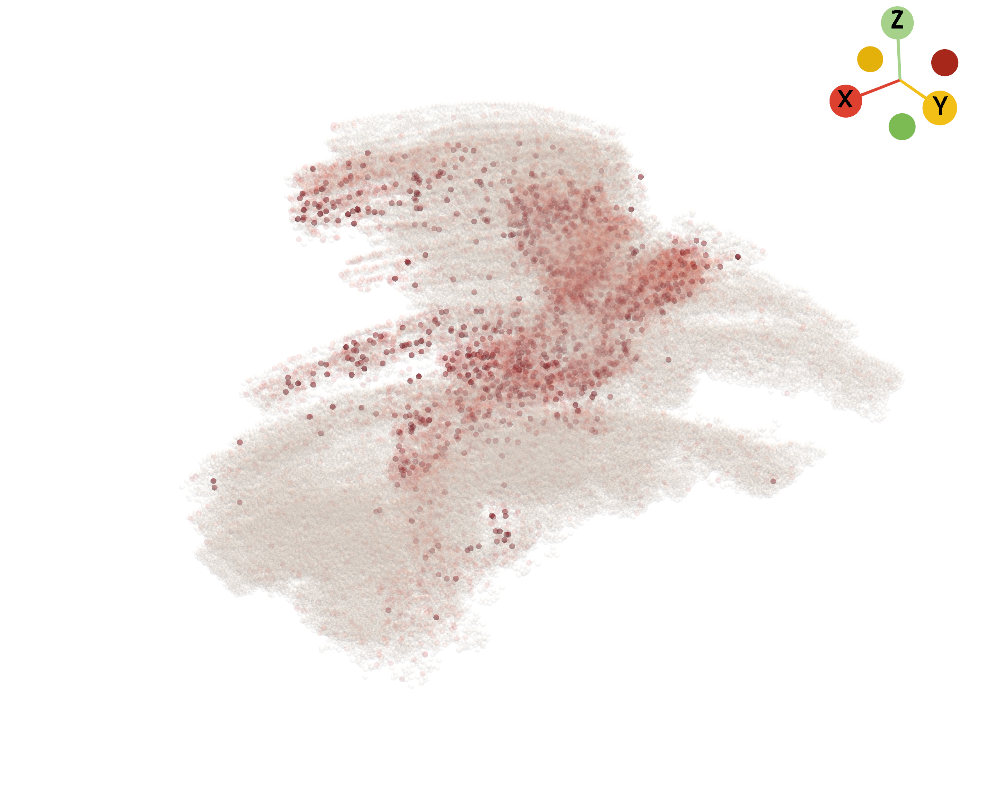

In [27]:
pc_index=pc_model.point_data["obs_index"].tolist()
exp = mhb[pc_index, "Ptn"].X.A.flatten()
exp[exp <= 0] = 0

amap = exp.copy()
amap = amap / np.max(amap)
amap[amap <= 0.5] = 0.1
add_model_labels(model=pc_model, labels=exp, key_added="Ptn", alphamap=amap, where="point_data",inplace=True, colormap="Reds")

st.pl.three_d_plot(
    model = pc_model,
    key = "Ptn",
    model_style ="points",
    model_size = 15,
    opacity = 1,
    colormap = None,
    show_legend = True,
    jupyter = "static",
    off_screen = False,
    cpo = cpo,
    window_size = (2560, 2048),
    filename = os.path.join(img_out_dir, f"mouse_E11.5_mhb_Ptn.tiff")
)

In [28]:
def collect_b_Ptn_columns(directory_path):
    # Initialize an empty DataFrame to store the collected data
    collected_data = pd.DataFrame()

    # Iterate through all files in the directory
    for filename in os.listdir(directory_path):
        if filename.endswith('.csv') and '_' in filename:
            # Extract the id part from the filename
            file_id = filename.split('_')[-1].split('.')[0]

            # Read the 'b_Ptn' column from the file
            file_path = os.path.join(directory_path, filename)
            data = pd.read_csv(file_path, usecols=['b_Ptn'])

            # Rename the column to the extracted id and add it to the collected data
            data.rename(columns={'b_Ptn': file_id}, inplace=True)
            collected_data = pd.concat([collected_data, data], axis=1)

    return collected_data

In [29]:
result_df = collect_b_Ptn_columns(cci_output_directory)
result_df

,Ebf2,Alpl,Gad2,Zfpm2,Mark1,Nrxn1,St18,Cdc25b,Rgmb,Crabp1,...,Rtn1,Flrt3,Arl4a,Abcc4,Rab3c,Rmst,Il17rd,Ier5,Helt,Zcchc18
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
124302,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
124303,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
124304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
124305,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [30]:
# This subset are Ptn target genes
targets = ["Nrxn3", "Gap43", "Rtn1", "Akap6", "Mapk10", "Nrxn1", "Sorcs1", "Lrrc4c", "Pak3", "Pam", "Flrt3", "Arl4a", "Rgmb"]
result_df = result_df[targets]
result_df

,Nrxn3,Gap43,Rtn1,Akap6,Mapk10,Nrxn1,Sorcs1,Lrrc4c,Pak3,Pam,Flrt3,Arl4a,Rgmb
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
124302,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
124303,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
124304,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
124305,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [31]:
n_target_expr = (mhb[:, targets].X.toarray() > 0).sum(axis=0)
n_target_expr

array([ 6247,  6331,  8070,  7083,  4779,  6655,  3302,  8700, 11619,
        9425,  6093,  6277, 12207])

In [32]:
proportions = (result_df > 0).sum() / n_target_expr
proportions

Nrxn3     0.449816
Gap43     0.334228
Rtn1      0.405204
Akap6     0.448539
Mapk10    0.433773
Nrxn1     0.399399
Sorcs1    0.508480
Lrrc4c    0.519195
Pak3      0.405457
Pam       0.479576
Flrt3     0.502708
Arl4a     0.410865
Rgmb      0.414598
dtype: float64

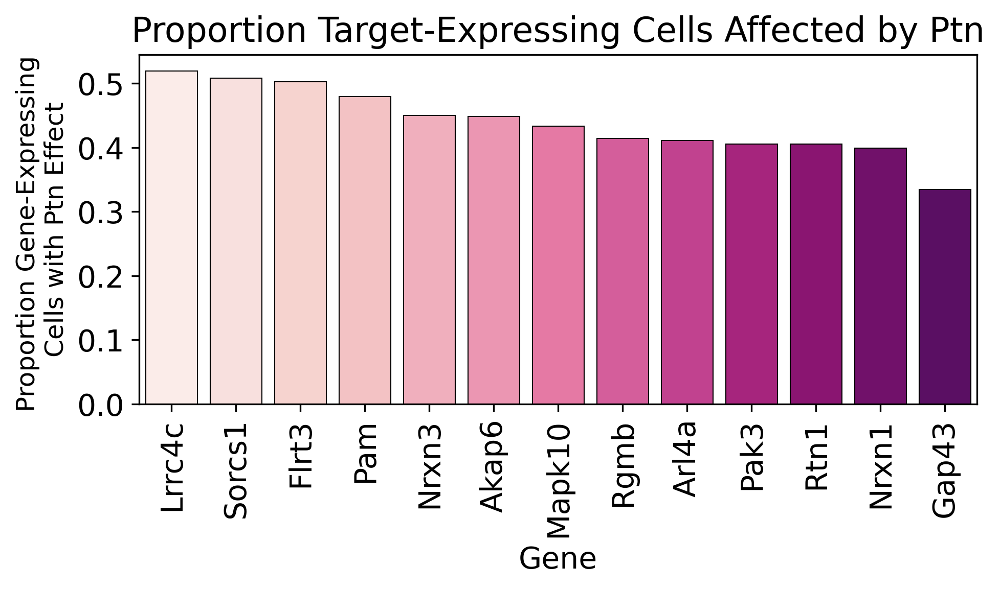

In [33]:
fig, ax = plt.subplots(figsize=(7, 3))

top = proportions.sort_values(ascending=False)

# Create a vertical barplot with a line around each bar using the Series
sns.barplot(x=top.index, y=top.values, palette='RdPu', ax=ax, edgecolor='black')

# Rotate x-axis labels for better readability
plt.xticks(rotation=90, fontsize=14)
plt.yticks(fontsize=14)

# Customize the plot
ax.set_title(f'Proportion Target-Expressing Cells Affected by Ptn', fontsize=16)
ax.set_xlabel('Gene', fontsize=14)
ax.set_ylabel('Proportion Gene-Expressing \nCells with Ptn Effect', fontsize=12)

# Show the plot
plt.show()

### Figure S6d- Cdh2, Tox, Abcc4 spatial scatterplots

In [34]:
cpo=[(1828.0804220206355, 864.2866840683831, 1107.147194210546),
 (1399.9631407079332, 216.45460007487026, 647.5),
 (-0.3184995571078608, -0.3994545448767145, 0.8596476596254036)]

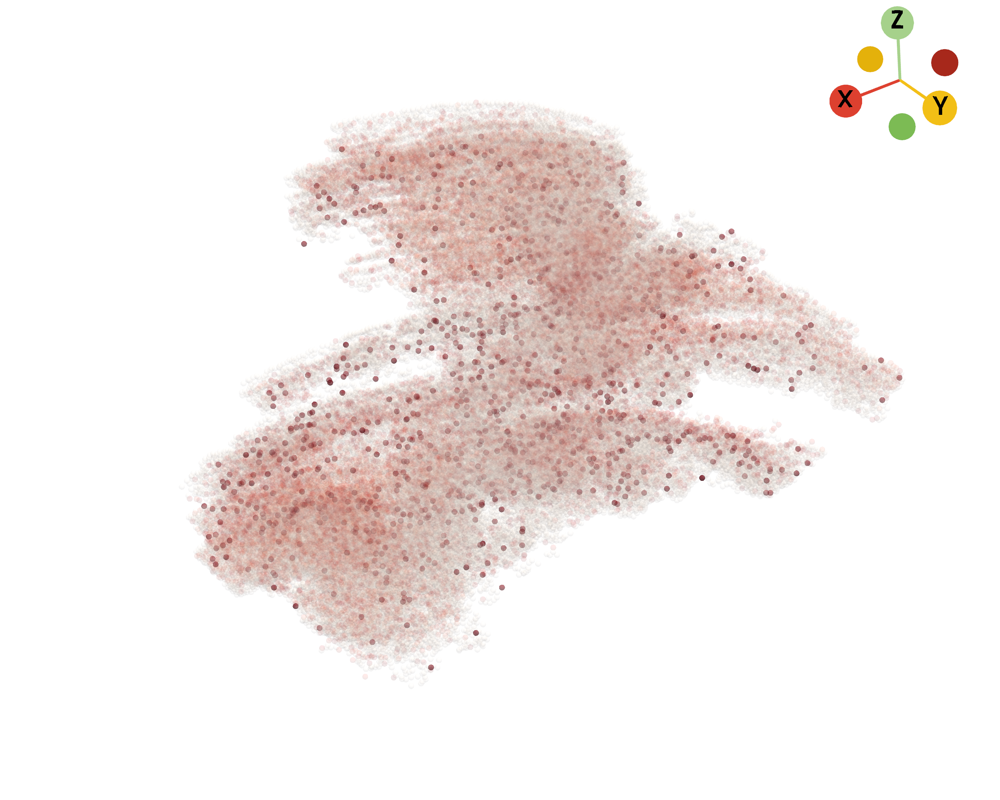

In [35]:
pc_index=pc_model.point_data["obs_index"].tolist()
exp = mhb[pc_index, "Cdh2"].X.A.flatten()
exp[exp <= 0] = 0

amap = exp.copy()
amap = amap / np.max(amap)
amap[amap <= 0.5] = 0.1
add_model_labels(model=pc_model, labels=exp, key_added="Cdh2", alphamap=amap, where="point_data",inplace=True, colormap="Reds")

st.pl.three_d_plot(
    model = pc_model,
    key = "Cdh2",
    model_style ="points",
    model_size = 15,
    opacity = 1,
    colormap = None,
    show_legend = True,
    jupyter = "static",
    off_screen = False,
    cpo = cpo,
    window_size = (2560, 2048),
    filename = os.path.join(img_out_dir, f"mouse_E11.5_mhb_Cdh2.tiff")
)

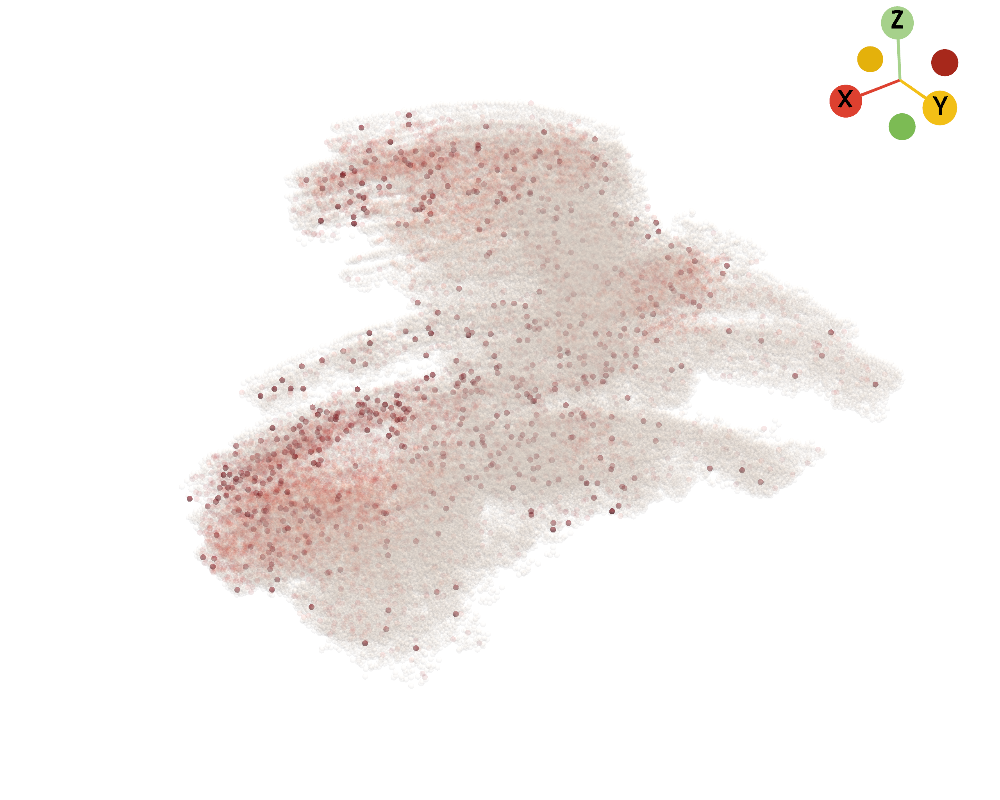

In [36]:
pc_index=pc_model.point_data["obs_index"].tolist()
exp = mhb[pc_index, "Tox"].X.A.flatten()
exp[exp <= 0] = 0

amap = exp.copy()
amap = amap / np.max(amap)
amap[amap <= 0.5] = 0.1
add_model_labels(model=pc_model, labels=exp, key_added="Tox", alphamap=amap, where="point_data",inplace=True, colormap="Reds")

st.pl.three_d_plot(
    model = pc_model,
    key = "Tox",
    model_style ="points",
    model_size = 15,
    opacity = 1,
    colormap = None,
    show_legend = True,
    jupyter = "static",
    off_screen = False,
    cpo = cpo,
    window_size = (2560, 2048),
    filename = os.path.join(img_out_dir, f"mouse_E11.5_mhb_Tox.tiff")
)

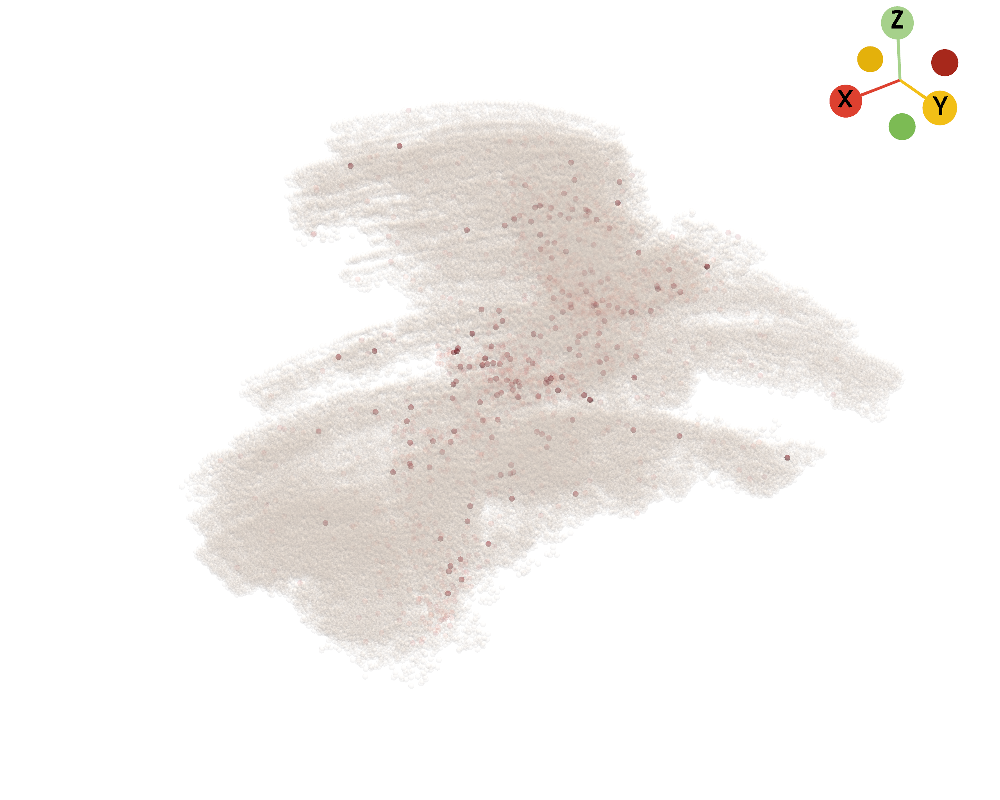

In [37]:
pc_index=pc_model.point_data["obs_index"].tolist()
exp = mhb[pc_index, "Abcc4"].X.A.flatten()
exp[exp <= 0] = 0

amap = exp.copy()
amap = amap / np.max(amap)
amap[amap <= 0.5] = 0.1
add_model_labels(model=pc_model, labels=exp, key_added="Abcc4", alphamap=amap, where="point_data",inplace=True, colormap="Reds")

st.pl.three_d_plot(
    model = pc_model,
    key = "Abcc4",
    model_style ="points",
    model_size = 15,
    opacity = 1,
    colormap = None,
    show_legend = True,
    jupyter = "static",
    off_screen = False,
    cpo = cpo,
    window_size = (2560, 2048),
    filename = os.path.join(img_out_dir, f"mouse_E11.5_mhb_Abcc4.tiff")
)

### Figure S6e- Cdh2 predicted effects spatial scatterplots

In [38]:
tox_data_path = "/home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/key_mhb_genes/key_mhb_genes_Tox.csv"

In [39]:
tox_data = pd.read_csv(tox_data_path, index_col=0).loc[mhb.obs.index, "b_Cdh2"]

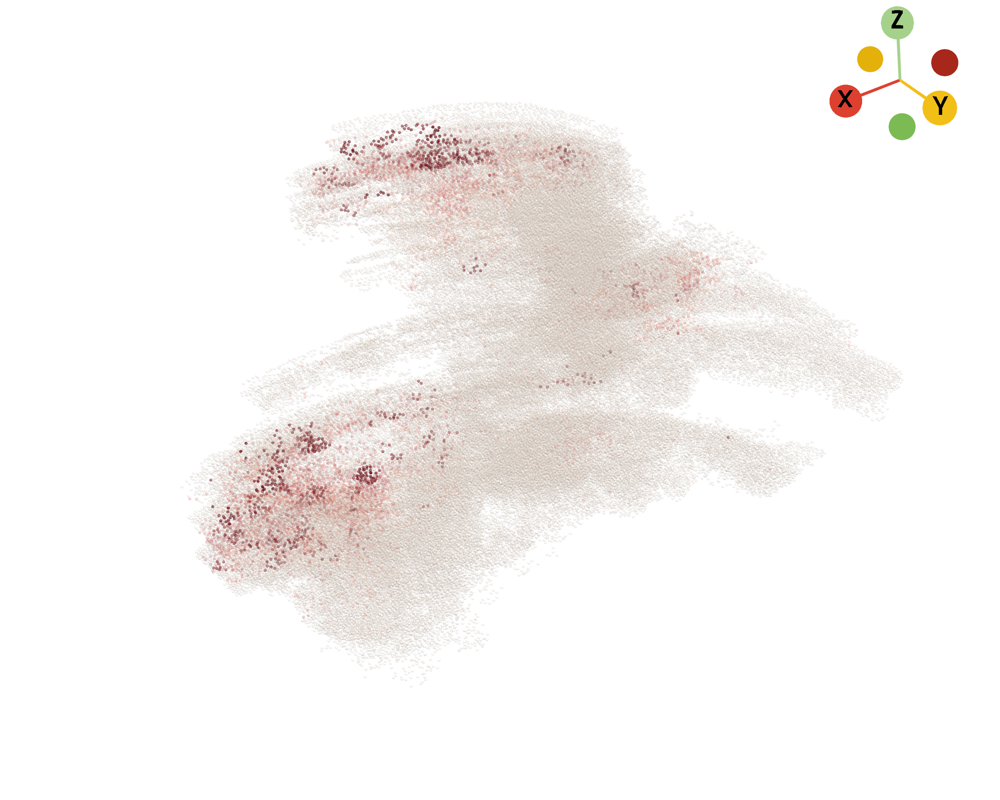

In [41]:
exp = np.asarray(tox_data)
exp[exp <= 0] = 0

amap = exp.copy()
amap = amap / np.max(amap)
amap[amap <= 0.5] = 0.2
add_model_labels(model=pc_model, labels=exp, key_added="b_Cdh2", alphamap=amap, where="point_data",inplace=True, colormap="Reds")

st.pl.three_d_plot(
    model = pc_model,
    key = "b_Cdh2",
    model_style ="points",
    model_size = 12,
    opacity = 1,
    colormap = None,
    show_legend = True,
    jupyter = "static",
    off_screen = False,
    cpo = cpo,
    window_size = (2560, 2048),
    filename = os.path.join(img_out_dir, f"MHB_Tox_b_Cdh2_pc_model.tiff")
)

In [42]:
abcc4_data_path = "/home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/key_mhb_genes/key_mhb_genes_Abcc4.csv"

In [43]:
abcc4_data = pd.read_csv(abcc4_data_path, index_col=0).loc[mhb.obs.index, "b_Cdh2"]

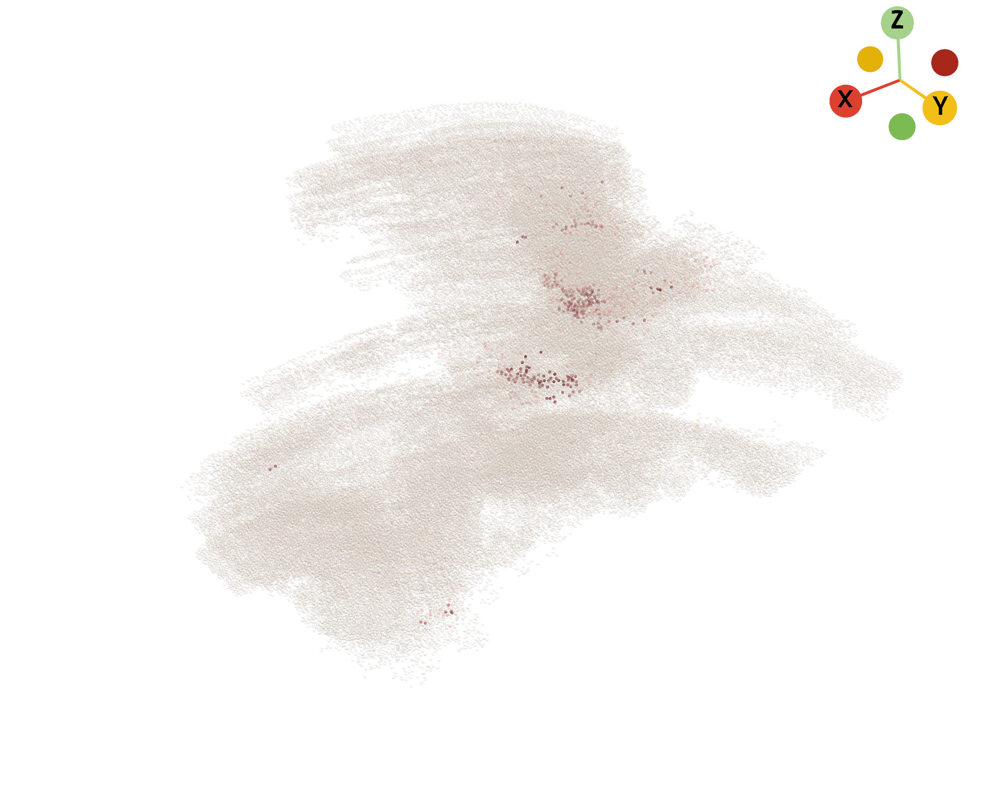

In [44]:
exp = np.asarray(abcc4_data)
exp[exp <= 0] = 0

amap = exp.copy()
amap = amap / np.max(amap)
amap[amap <= 0.5] = 0.2
add_model_labels(model=pc_model, labels=exp, key_added="b_Cdh2", alphamap=amap, where="point_data",inplace=True, colormap="Reds")

st.pl.three_d_plot(
    model = pc_model,
    key = "b_Cdh2",
    model_style ="points",
    model_size = 12,
    opacity = 1,
    colormap = None,
    show_legend = True,
    jupyter = "static",
    off_screen = False,
    cpo = cpo,
    window_size = (2560, 2048),
    filename = os.path.join(img_out_dir, f"MHB_Abcc4_b_Cdh2_pc_model.tiff")
)

## Digitize the spinal cord using 2D representations

### Figure S6f&g- D-V digitization of the spinal cord and Lhx gene expression on the X-Y plane

In [45]:
path_to_sc = "/home/danielyumengzhu/Single-cell-data/cellbin_mouse_embryo_aligned_E11.5/E11.5_spinal_cord_final.h5ad"

In [46]:
adata_spin = anndata.read_h5ad(path_to_sc)
adata_spin.uns["__type"] = "UMI"
adata_spin

AnnData object with n_obs × n_vars = 575281 × 21717
    obs: 'area', 'n_genes_by_counts', 'total_counts', 'n_counts', 'louvain', 'transf_anno', 'ManualAnnotation', 'embryo_id', 'mapped_celltype', 'slice_id'
    uns: '__type'
    obsm: 'X_pca', 'bbox', 'spatial', 'spatial_regis_xz', 'z_correction'
    layers: 'X_smooth', 'count'

|-----> Set up the color for the clusters with the tab20 colormap.
|-----> Saving integer labels for clusters into adata.obs['cluster_img_label'].
|-----> Prepare a mask image and assign each pixel to the corresponding cluster id.
|-----> Get selected areas with label id(s): [1].
|-----> Close morphology of the area formed by cluster [1].
|-----> Remove small region(s).
|-----> Extract contours.
|-----> Initialize the field of the spatial domain of interests.
|-----> Prepare the isoline segments with either the highest/lower column or layer heat values.
|-----> Solve the layer heat equation on spatial domain with the iso-layer-line conditions.
|-----> Total iteration: 5383
|-----> Saving layer heat values to digital_layer.
cell_5831      0.0
cell_5832      0.0
cell_5834      0.0
cell_5835      0.0
cell_5836      0.0
              ... 
cell_379417    0.0
cell_453552    0.0
cell_453778    0.0
cell_453813    0.0
cell_453824    0.0
Name: digital_layer, Length: 575281, dtype: float64
|-----

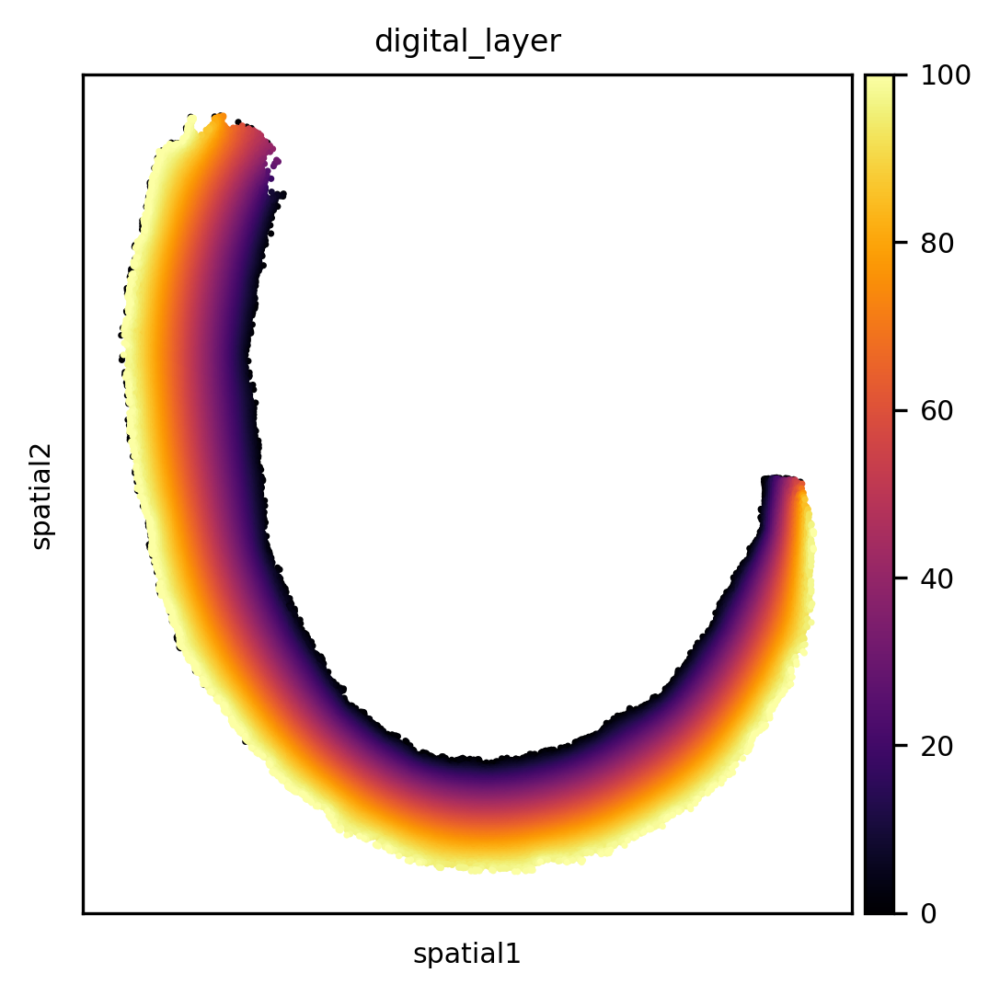

In [47]:
adata_spin.obsm['spatial'] = adata_spin.obsm['z_correction'][:,:2].copy()
adata_spin.obs['label'] = "Spinal_Cord"
adata_spin.obsm['spatial_bin3'] = adata_spin.obsm['spatial']//3
cluster_label_image_lowres = st.dd.gen_cluster_image(adata_spin, bin_size=1, spatial_key="spatial_bin3", cluster_key='label', show=False)
cluster_label_list = np.unique(adata_spin.obs["cluster_img_label"])
contours, cluster_image_close, cluster_image_contour = st.dd.extract_cluster_contours(
    cluster_label_image_lowres,
    cluster_label_list,
    bin_size=1,
    k_size=10,
    min_area=100,
    show=False,
)

# %%
pnt_xY = (149,230)
pnt_xy = (188,276)
pnt_Xy = (333,521)
pnt_XY = (344,545)

st.dd.digitize(
    adata=adata_spin,
    ctrs=contours,
    ctr_idx=0,
    pnt_xy=pnt_xy,
    pnt_xY=pnt_xY,
    pnt_Xy=pnt_Xy,
    pnt_XY=pnt_XY,
    spatial_key="spatial_bin3"
)

sc.pl.spatial(
    adata_spin,
    spot_size=10, 
    color_map="inferno",
    color=['digital_layer']
)

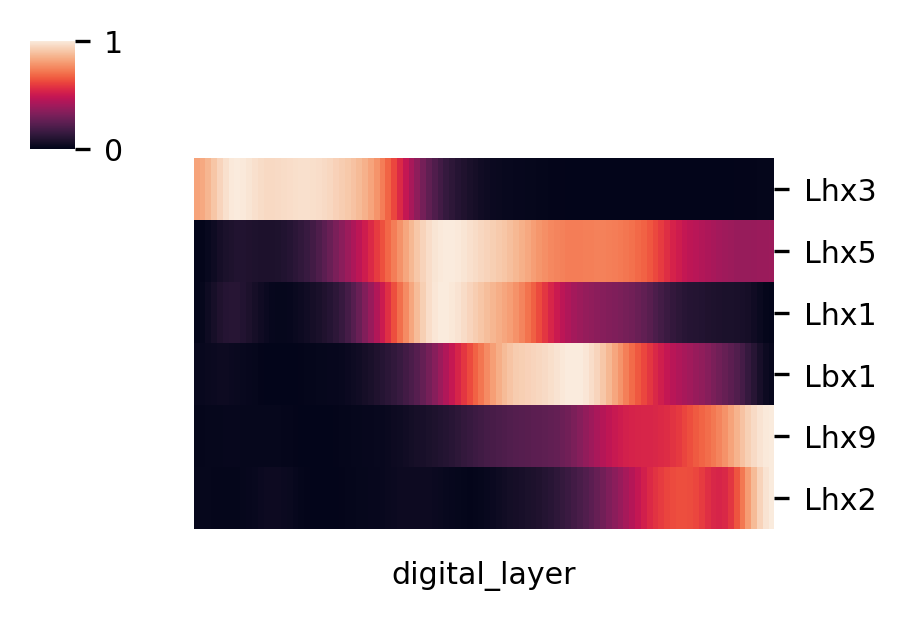

In [48]:
selected_gene=['Lhx3', 'Lhx5', 'Lhx1', 'Lbx1', 'Lhx9', 'Lhx2']

adata_sub = adata_spin[:,selected_gene][adata_spin.obs['digital_layer'] != 0].copy()

# aggregate the gene expression in each digitized columns/layers
exp_mtx = adata_sub.X.todense()
exp_mtx = pd.DataFrame(exp_mtx, index=adata_sub.obs.index, columns=adata_sub.var.index)
exp_mtx["digital_layer"] = adata_sub.obs["digital_layer"].astype(int).to_list()
agg_exp_column = exp_mtx.groupby(["digital_layer"]).mean()
agg_exp_column = agg_exp_column.transpose().sort_index(axis=1)

# smooth the heatmap
from scipy.ndimage import gaussian_filter1d

agg_exp_column_tmp = agg_exp_column.copy()


agg_exp_column_tmp = agg_exp_column_tmp.apply(
    lambda x: gaussian_filter1d(x, 3).tolist(),
    axis=1,
)
agg_exp_column_tmp = pd.DataFrame(
    agg_exp_column_tmp.to_list(),
    index=agg_exp_column.index,
    columns=agg_exp_column.columns,
)

sns.clustermap(
    agg_exp_column_tmp,
    standard_scale=0,
    col_cluster=False,
    row_cluster=False,
    xticklabels=False,
    figsize=(3,2)
)

### Figure S6i- visualizing Gbx and Dbx in spinal cord using pseudo-transverse plane

In [49]:
# A different AnnData object contains necessary information for plotting transverse plane plot
path_to_tp = "/home/danielyumengzhu/Single-cell-data/cellbin_mouse_embryo_aligned_E11.5/E11.5_spinal_cord_tp.h5ad"

In [50]:
adata_tp = anndata.read_h5ad(path_to_tp)

In [51]:
### Generate X-Z representation of Gbx+ and Dbx+
df3d_xz = pd.DataFrame(adata_tp.obsm['spatial_regis_xz'],columns=['new_X','new_Z'])

Dbx1 = adata_tp[:,['Dbx1']].to_df()
Gbx2 = adata_tp[:,['Gbx2']].to_df()
Dbx1.index=range(Dbx1.shape[0])
Gbx2.index=range(Gbx2.shape[0])
list1 = Dbx1[Dbx1.Dbx1>0].index.to_list()
list2 = Gbx2[Gbx2.Gbx2>0].index.to_list()

df3d_xz2 = df3d_xz.copy()
df3d_xz2['Genes'] = 'noExpress'
df3d_xz2.loc[df3d_xz2.index.isin(list2),'Genes'] = 'Gbx2'
df3d_xz2.loc[df3d_xz2.index.isin(list1),'Genes'] = 'Dbx1'

df3d_xz2 = df3d_xz2.sort_values("Genes",ascending=False)

<AxesSubplot: xlabel='new_X', ylabel='new_Z'>

/home/danielyumengzhu/spateo_env/lib/python3.8/site-packages/IPython/core/events.py:89: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.

/home/danielyumengzhu/spateo_env/lib/python3.8/site-packages/IPython/core/pylabtools.py:152: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



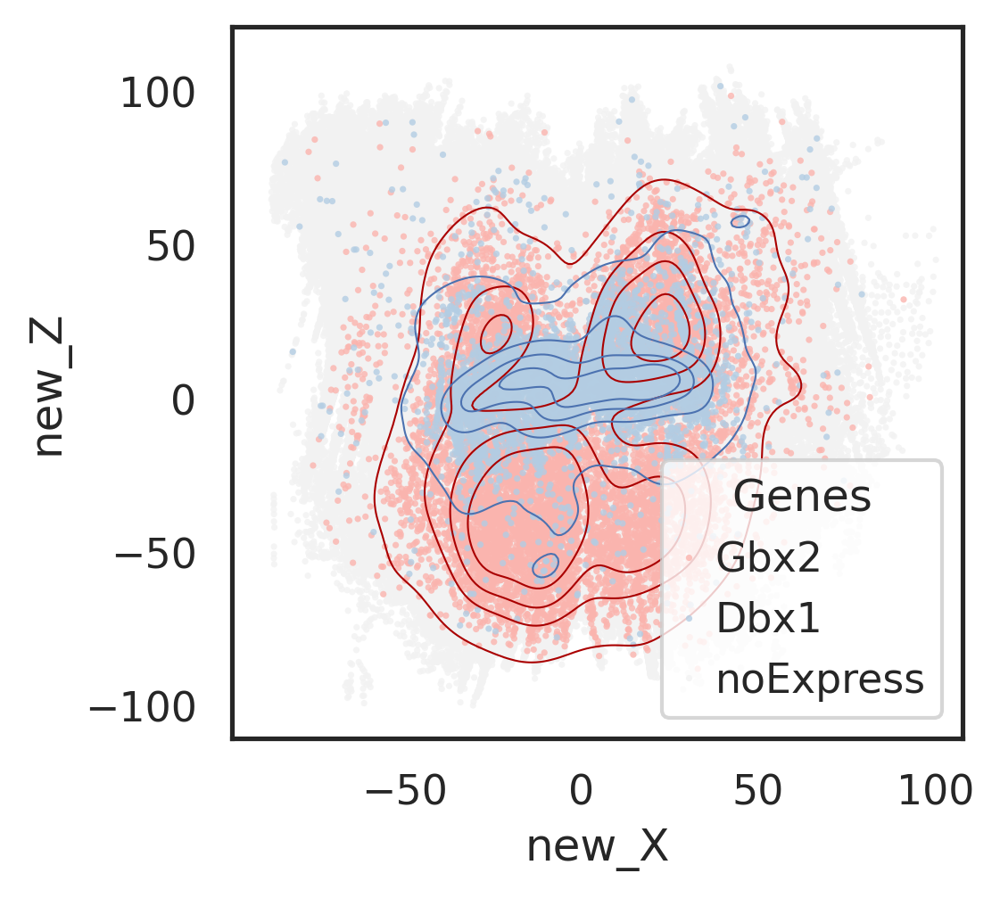

In [52]:
import seaborn as sns

sns.set_theme(style="white")

f, ax = plt.subplots(figsize=(3.5, 3.5))

sns.scatterplot(data=df3d_xz2,
                x="new_X", y="new_Z", s=3,hue="Genes",linewidth=0,alpha=0.8,
                hue_order=[ 'Gbx2', 'Dbx1','noExpress',],
                palette=['#fbb4ae','#b3cde3','#f2f2f2'],#"Pastel1",
                rasterized=True,
               )

sns.kdeplot(data=df3d_xz2[df3d_xz2['Genes']=="Gbx2"],
    x="new_X", y="new_Z", levels=5, color="#AA0000", linewidths=0.5)
sns.kdeplot(data=df3d_xz2[df3d_xz2['Genes']=="Dbx1"],
    x="new_X", y="new_Z", levels=5, color="b", linewidths=0.5)

## For the next two sections- run CCI modeling + downstream modeling on the spinal cord interneuron subset

In [53]:
database_dir = "/home/danielyumengzhu/spateo-release/spateo/tools/database"

In [54]:
# Set to the folders that the inputs (ligands list, target genes list) are contained in and that the outputs (model results) will save to:
cci_input_directory = "/home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/spinal_cord_CCI_analysis_inputs"
cci_output_directory = "/home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/key_spinal_cord_genes"
cci_output_id = os.path.join(cci_output_directory, "key_spinal_cord_genes.csv")
cci_ligands_file = os.path.join(cci_input_directory, "spinal_cord_ligands.txt")
cci_targets_file = os.path.join(cci_input_directory, "spinal_cord_targets.txt")

In [55]:
path_to_sc = "/home/danielyumengzhu/Single-cell-data/cellbin_mouse_embryo_aligned_E11.5/E11.5_spinal_cord_final.h5ad"
path_to_sc_interneuron = "/home/danielyumengzhu/Single-cell-data/cellbin_mouse_embryo_aligned_E11.5/E11.5_spinal_interneuron_subset.h5ad"

In [56]:
# We use the full spinal cord to identify upper and lower bounds for the bandwidth
e115_sc = anndata.read_h5ad(path_to_sc)
e115_sc.uns["__type"] = "UMI"

In [57]:
lb = st.tl.find_neighbors.find_bw_for_n_neighbors(
    e115_sc,
    coords_key="z_correction",
    n_anchors=2000,
    target_n_neighbors=27,
    initial_bw=20,
    exclude_self=True
)

2024-08-17 17:02:05.803083: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-08-17 17:02:05.813211: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-08-17 17:02:05.838643: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-08-17 17:02:05.848279: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-08-17 17:02:06.389118: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Coul

Initial bandwidth: 20
For bandwidth 20, found 700.907 neighbors on average.
Iteration 1, new bandwidth: 3.9253797621752455
For bandwidth 3.9253797621752455, found 6.7465 neighbors on average.
Iteration 2, new bandwidth: 7.852795698329057
For bandwidth 7.852795698329057, found 51.8175 neighbors on average.
Iteration 3, new bandwidth: 5.668497414077753
For bandwidth 5.668497414077753, found 19.2455 neighbors on average.
Iteration 4, new bandwidth: 6.714060272801146
For bandwidth 6.714060272801146, found 33.5605 neighbors on average.
Iteration 5, new bandwidth: 6.02216854943019
For bandwidth 6.02216854943019, found 23.851 neighbors on average.
Iteration 6, new bandwidth: 6.407394916395849
For bandwidth 6.407394916395849, found 29.143 neighbors on average.
Final bandwidth: 6.407394916395849


In [58]:
ub = st.tl.find_neighbors.find_bw_for_n_neighbors(
    e115_sc,
    coords_key="z_correction",
    n_anchors=2000,
    target_n_neighbors=270,
    initial_bw=20,
    exclude_self=True
)

2024-08-17 17:03:01.317061: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-08-17 17:03:01.320161: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-08-17 17:03:01.351978: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-08-17 17:03:01.354669: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-08-17 17:03:01.905337: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Coul

Initial bandwidth: 20
For bandwidth 20, found 700.907 neighbors on average.
Iteration 1, new bandwidth: 12.413140729603846
For bandwidth 12.413140729603846, found 187.9155 neighbors on average.
Iteration 2, new bandwidth: 14.87929174355237
For bandwidth 14.87929174355237, found 303.5415 neighbors on average.
Iteration 3, new bandwidth: 14.033147929914277
For bandwidth 14.033147929914277, found 261.671 neighbors on average.
Final bandwidth: 14.033147929914277


In [59]:
adata_path = path_to_sc_interneuron
output_path = cci_output_id
ligand_path = cci_ligands_file
target_path = cci_targets_file
cci_dir_path = database_dir
mod_type = "ligand"
distr = "poisson"
species = "mouse"
group_key = "mapped_celltype"
coords_key = "z_correction"
distance_membrane_bound = lb
distance_secreted = ub
spatial_subsample = True
total_counts_key = "total_counts"
total_counts_threshold = 3000.0
minbw = lb
maxbw = ub * 1.5

if not os.path.exists(os.path.dirname(output_path)):
    os.makedirs(os.path.dirname(output_path))

In [60]:
parser, args_list = st.tl.define_spateo_argparse(
    adata_path=adata_path,
    custom_lig_path=ligand_path,
    targets_path=target_path,
    cci_dir=cci_dir_path,
    mod_type=mod_type,
    distr=distr,
    species=species,
    group_key=group_key,
    coords_key=coords_key,
    distance_membrane_bound=distance_membrane_bound,
    distance_secreted=distance_secreted,
    spatial_subsample=spatial_subsample,
    total_counts_key=total_counts_key,
    total_counts_threshold=total_counts_threshold,
    minbw=minbw,
    maxbw=maxbw,
    output_path=output_path,
)

In [ ]:
import time

t1 = time.time()

swr_model = st.tl.MuSIC(parser, args_list)
swr_model._set_up_model()
swr_model.fit()
swr_model.predict_and_save()

t_last = time.time()

print("Total Time Elapsed:", np.round(t_last - t1, 2), "seconds")
print("-" * 60)

In [61]:
# Use the same parser object to set up downstream analysis
downstream_model = st.tl.MuSIC_Interpreter(parser, args_list)

------------------------------------------------------------
|-----> Spatial kernel: Adaptive Bisquare
|-----> Loading AnnData object from: /home/danielyumengzhu/Single-cell-data/cellbin_mouse_embryo_aligned_E11.5/E11.5_spinal_interneuron_subset.h5ad
|-----> Model type: ligand
|-----> Loading cell-cell interaction databases from the following folder:  /home/danielyumengzhu/spateo-release/spateo/tools/database.
|-----> Using list of custom ligands from: /home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/spinal_cord_CCI_analysis_inputs/spinal_cord_ligands.txt.
|-----> Using list of target genes from: /home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/spinal_cord_CCI_analysis_inputs/spinal_cord_targets.txt.
|-----> Saving all outputs to this directory: /home/danielyumengzhu/Single-cell-analysis/Spateo_E11.5_embryo_figures/key_spinal_cord_genes.
|-----> Running :func `SWR._set_up_model()` to organize predictors and targets for downstream analysis now

In [ ]:
# Predict TF regulators of ligands
downstream_model.CCI_deg_detection_setup(
    group_key="mapped_celltype",
    use_ligands=True,
    use_receptors=False,
    use_targets=False
)

In [ ]:
downstream_model.CCI_deg_detection(
    group_key="mapped_celltype",
    cci_dir_path=cci_dir_path,
    use_ligands=True,
    use_receptors=False,
    use_targets=False,
    use_dim_reduction=False,
    distr="poisson"
)

### Figure S6k- predicted regulators of Slit2

In [62]:
exclude = [
    "Rarb",
    "Pax2",
    "Rara",
    "Ctcf",
    "Zfp281",
    "Isl1",
    "Zfp652"
]

In [63]:
interaction_subset = [f.replace("regulator_", "") for f in downstream_model.downstream_model_ligand_design_matrix.columns if f.replace("regulator_", "") not in exclude]

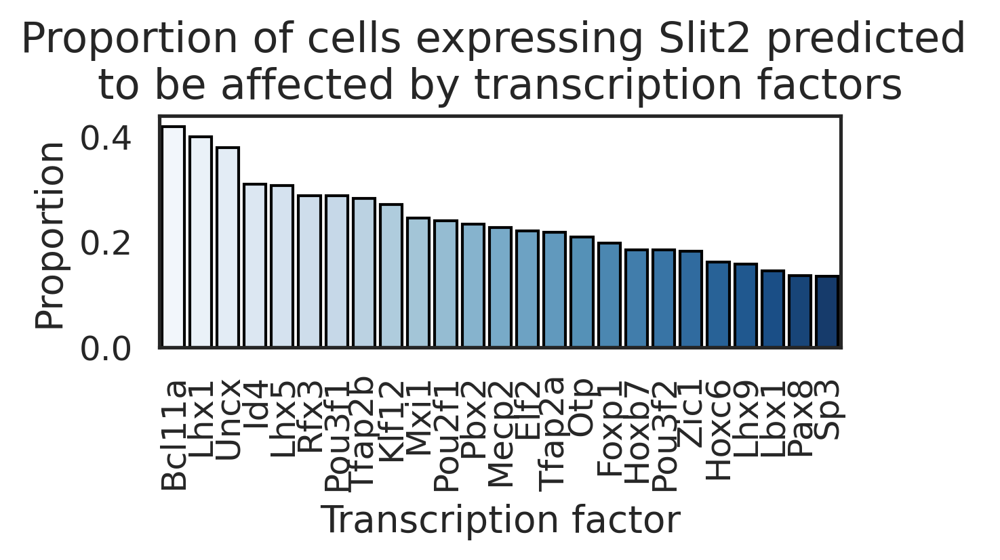

In [64]:
downstream_model.deg_effect_barplot(
    target="Slit2",
    interaction_subset=interaction_subset,
    top_n_interactions=25,
    figsize=(5, 1.5)
)

### Figure S6l- predicted targets of Slit2

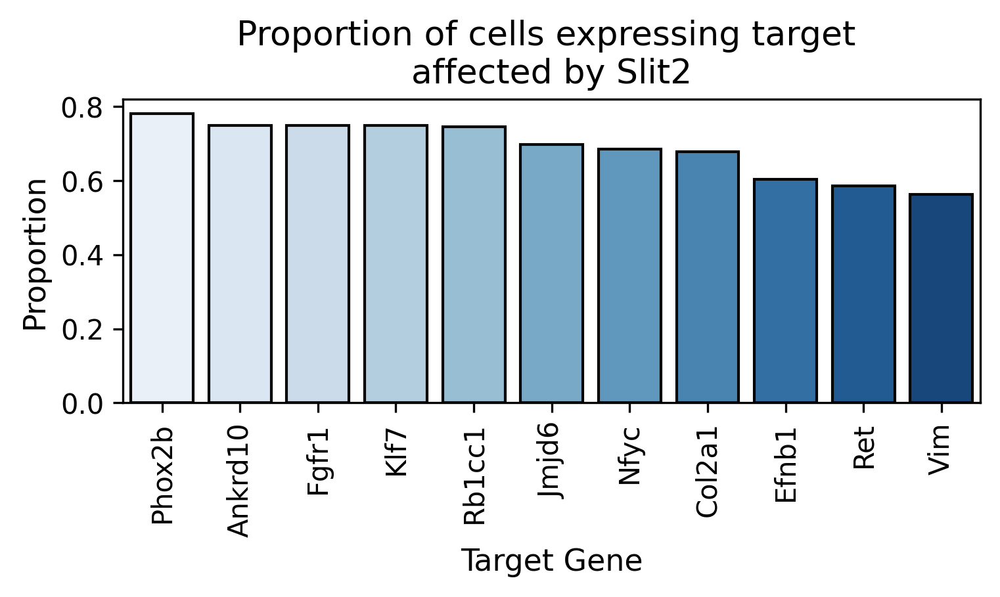

In [65]:
downstream_model.top_target_barplot(
    interaction="Slit2",
    figsize=(6, 2),
    top_n_targets=40
)